# First DVAE

# Parameters

In [1]:
model_name = "NAE"
signal_row = "mchi1"
bkg_train =  ["BhaBha",  "TauTau", "EEMuMu", "EEPiPi", "MuMuMuMu", "EEEE"] 
transformer_name = "feature_standard_scaler"

In [2]:
s = None

# Imports

## Packages

### base packages

In [3]:
import sys
import os
from itertools import *
from copy import copy, deepcopy
from typing import Dict, NamedTuple, Callable, List
import json
from tqdm import tqdm

### standard packages

In [4]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.patches import Rectangle, Polygon, Ellipse
import matplotlib.transforms as transforms
import matplotlib.gridspec as gridspec

### ML packages

In [5]:
from torch import save, load, tensor, manual_seed
manual_seed(0)
from sklearn.cluster import KMeans
from ADIDMDH.Dataset import IDMDHDataset
from ADIDMDH.Losses import MSE_Loss, ELBO, GMM_ELBO, Dirichlet_ELBO, KGMM_ELBO, Tilman_ELBO, MSE
from ADIDMDH.Trainer import Trainer
from ADIDMDH.Transformer import Transformer
from ADIDMDH.Models_dict import models_dict, available_transformer_dicts, feature_collection_dict, column_names_IDs, column_names_likelihoods, column_names_p, column_names_E

### IDMDH packages

In [6]:
from idmdh.utilities.utilities import dict_hash, uproottree2df
from idmdh.plotting.histogram_plots import HistogramPlot
from idmdh.plotting.plot_variables import HistVariable, BinningVariable
from idmdh.plotting.plot_functions import plot_variable_by, plot_correlation_footprints_cluster, plot_reco_comparison
from idmdh.plotting.plotting_utils import set_matplotlibrc_params, KITColors, add_model_params
from idmdh.mc_matching.mc_ids import TotalSigID
from idmdh.mc_production.model_parameters import ModelParameterDict
from idmdh.utilities.units import Unit
from idmdh.mc_production.processes import ProcessDict
from idmdh.n_tuple_production.datasets import ep3_background_file_dict

## Data Imports

### Backgrounds

In [7]:
path = "/ceph/jeppelt/simulation_idmdh/0208/training_selection/n_tuples/selected"
bkg_names = ["BhaBha",  "TauTau", "EEMuMu", "EEPiPi", "MuMuMuMu", "EEEE"] # 

bkg_df = pd.concat([pd.read_hdf(f"{path}/{n}1/{n}1_beam_training_selection_n_tuple.h5", stop = s) for n in bkg_names])
bkg_df = bkg_df[bkg_df["reco_channel_ID"] == 1]
bkg_df.reset_index(inplace = True, drop = True)

### Signals

In [8]:
signalpath = "/ceph/jeppelt/simulation_idmdh/0429/training_selection/n_tuples/selected/PhiMu_ChiTwoE"
sig_dicts = ModelParameterDict.get_variations_for_parameter(signal_row)[:3]
sig_mp = {ModelParameterDict.get_mp_combination_hash(dic): dic for dic in sig_dicts}
sig_dfs = {h: pd.read_parquet(f"{signalpath}/PhiMu_ChiTwoE_beam_training_selection_{h}_n_tuple.pq")[:5000] for h in sig_mp.keys()}

# Definitions

## plotting settings

In [9]:
import matplotlib as mpl
mpl.rcParams['figure.dpi'] = 150
pd.set_option('display.max_columns', 999)

## Savepath

In [10]:
savepath = f"/ceph/jeppelt/exports/DVAE/{transformer_name}/{model_name}/{str(bkg_train)}/"
if not os.path.exists(savepath):
    os.makedirs(savepath)
if not os.path.exists(f"{savepath}reco_comparison/"):
    os.makedirs(f"{savepath}reco_comparison/")

## Variables

In [11]:
latent_vars = [HistVariable(
    df_label=f"{model_name}_latent_{i}",
    label = f"latent variable {i}",
    bins = 50,
) for i in range(3)]
mse_var = HistVariable(
    df_label=f"{model_name}_mse",
    label = f"MSE",
    bins = 50,)
p_reco_vars = [HistVariable(
    df_label=f"{model_name}_{col}_train",
    label = f"{col}",
    bins = 50,
) for col in column_names_p()]
E_reco_vars = [HistVariable(
    df_label=f"{model_name}_{col}_train",
    label = f"{col}",
    bins = 50,
) for col in column_names_E()]
ID_reco_vars = [HistVariable(
    df_label=f"{model_name}_{col}_train",
    label = f"{col}",
    bins = 50,
) for col in column_names_likelihoods()]
reco_vars = E_reco_vars + p_reco_vars + ID_reco_vars

## Backgroundclasses

In [12]:
class SigComponent(NamedTuple):
    label: str
    ID: int
    color: str
    lumi: float
    query: str
    df_label: str

In [13]:
h_categories_dict = {"correct": "daughter_0_daughter_0_matchedMC_PDG == -13 & daughter_0_daughter_1_matchedMC_PDG == 13",
                   "electrons": '(daughter_0_daughter_0_matchedMC_PDG == -11 & daughter_0_daughter_1_matchedMC_PDG == 11) |' +
                                '((daughter_0_daughter_0_matchedMC_PDG == -11 | daughter_0_daughter_1_matchedMC_PDG == 11)' + 
                                '& (daughter_0_daughter_0_matchedMC_PDG == -13 | daughter_0_daughter_1_matchedMC_PDG == 13)) ',
                   "pions": "abs(daughter_0_daughter_0_matchedMC_PDG) == 211 & abs(daughter_0_daughter_1_matchedMC_PDG) == 211",
                   "unmatched": 'daughter_0_daughter_0_matchedMC_PDG != daughter_0_daughter_0_matchedMC_PDG |'+
                                'daughter_0_daughter_1_matchedMC_PDG != daughter_0_daughter_1_matchedMC_PDG',
                   "semi pionic": '(daughter_0_daughter_0_matchedMC_PDG == 211 | daughter_0_daughter_1_matchedMC_PDG == -211)' +
                                  '& ~(abs(daughter_0_daughter_0_matchedMC_PDG) == 211 & abs(daughter_0_daughter_1_matchedMC_PDG) == 211)'+
                                  ' & ~(daughter_0_daughter_0_matchedMC_PDG != daughter_0_daughter_0_matchedMC_PDG |'+
                                  'daughter_0_daughter_1_matchedMC_PDG != daughter_0_daughter_1_matchedMC_PDG)',}

In [14]:
chi_categories_dict = {"correct": "daughter_1_daughter_0_matchedMC_PDG == -11 & daughter_1_daughter_1_matchedMC_PDG == 11",
                   "muons": '(daughter_1_daughter_0_matchedMC_PDG == -13 & daughter_1_daughter_1_matchedMC_PDG == 13) |' +
                                '((daughter_1_daughter_0_matchedMC_PDG == -13 | daughter_1_daughter_1_matchedMC_PDG == 13)' + 
                                '& (daughter_1_daughter_0_matchedMC_PDG == -11 | daughter_1_daughter_1_matchedMC_PDG == 11)) ',
                   "pions": "daughter_1_daughter_0_matchedMC_PDG == 211 & daughter_1_daughter_1_matchedMC_PDG == -211",
                   "unmatched": 'daughter_1_daughter_0_matchedMC_PDG != daughter_1_daughter_0_matchedMC_PDG |'+
                                'daughter_1_daughter_1_matchedMC_PDG != daughter_1_daughter_1_matchedMC_PDG',
                   "semi pionic": '(daughter_1_daughter_0_matchedMC_PDG == 211 | daughter_1_daughter_1_matchedMC_PDG == -211)' +
                                  '& ~(abs(daughter_1_daughter_0_matchedMC_PDG) == 211 & abs(daughter_1_daughter_1_matchedMC_PDG) == 211)'+
                                  ' & ~(daughter_1_daughter_0_matchedMC_PDG != daughter_1_daughter_0_matchedMC_PDG |'+
                                  'daughter_1_daughter_1_matchedMC_PDG != daughter_1_daughter_1_matchedMC_PDG)',}

In [15]:
kit_green_light = "#00e6c7"
kit_green_dark = "#005c4f"
kit_grey_dark = "#4d4d4d"
kit_grey_light = "#797979"
kit_may = "#8cb63c"
kit_may_light = "#b6ed4c"
kit_may_dark = "#597523"
black = "#000000"
light_black = "#0000b8"
kit_brown = "#a7822e"

In [16]:
bkg_subclasses = [
    SigComponent(
        label=r"$\tau^{+} \tau^{-}$",
        ID=10,
        color=kit_brown,
        lumi = 100.0,
        query = "SIG_ID == 16",
        df_label = "BKG_class",
    ),
    SigComponent(
        label=r"$e^{+} e^{-} \mu^{+} \mu^{-}$, corr. $\chi$",
        ID=1,
        color=kit_green_light,
        lumi = 100.0,
        query = f"SIG_ID == 15 and ("+ chi_categories_dict["correct"] + ")",
        df_label = "BKG_class",
    ),
    SigComponent(
        label=r"$e^{+} e^{-} \mu^{+} \mu^{-}$, unm. $\chi$",
        ID=2,
        color=kit_green_dark,
        lumi = 100.0,
        query = f"SIG_ID ==15 and ("+ chi_categories_dict["unmatched"] + ")",
        df_label = "BKG_class",
    ),
    SigComponent(
        label=r"Bhabha, ele $h^\prime$",
        ID=4,
        color=kit_grey_light,
        lumi = 10.0,
        query = f"SIG_ID == 18 and ("+ h_categories_dict["electrons"] + ")",
        df_label = "BKG_class",
    ),
    SigComponent(
        label=r"Bhabha, unm $h^\prime$",
        ID=3,
        color=kit_grey_dark,
        lumi = 10.0,
        query = f"SIG_ID == 18 and ("+ h_categories_dict["unmatched"] + ")",
        df_label = "BKG_class",
    ),
    SigComponent(
        label=r"$e^{+} e^{-} e^{+} e^{-}$, ele. $h^\prime$",
        ID=5,
        color=kit_may,
        lumi = 100.0,
        query = f"SIG_ID == 19 and ("+ h_categories_dict["electrons"] + ")",
        df_label = "BKG_class",
    ),
    SigComponent(
        label=r"$e^{+} e^{-} e^{+} e^{-}$, corr. $\chi$",
        ID=6,
        color=kit_may_light,
        lumi = 100.0,
        query = f"SIG_ID == 19 and ("+ chi_categories_dict["correct"] + ") and (" + h_categories_dict["unmatched"] + ")",
        df_label = "BKG_class",
    ),    
    SigComponent(
        label=r"$e^{+} e^{-} e^{+} e^{-}$, unm. $\chi$",
        ID=7,
        color=kit_may_dark,
        lumi = 100.0,
        query = f"SIG_ID == 19 and ("+ chi_categories_dict["unmatched"] + ") and (" + h_categories_dict["unmatched"] + ")",
        df_label = "BKG_class",
    ),
    SigComponent(
        label=r"$e^{+} e^{-} \pi^{+} \pi^{-}$",
        ID=8,
        color=KITColors.kit_yellow,
        lumi = 100.0,
        query = f"SIG_ID == 20",
        df_label = "BKG_class",
    ),
    SigComponent(
        label=r"$\mu^{+} \mu^{-} \mu^{+} \mu^{-}$",
        ID=9,
        color=KITColors.light_grey,
        lumi = 2000.0,
        query = "SIG_ID == 17",
        df_label = "BKG_class",
    ),
]

In [17]:
bkg_df["BKG_class"] = 0
for c in bkg_subclasses:
    bkg_df.loc[bkg_df.eval(c.query),"BKG_class"] = c.ID

# Load Model

In [18]:
transformer_dict = available_transformer_dicts[transformer_name]
transformer = Transformer(transformer_dict = transformer_dict, path = f"/ceph/jeppelt/exports/DVAE/{transformer_name}")
train_column_names = column_names_IDs()

In [19]:
from omegaconf import OmegaConf
from models import get_model

cfg = OmegaConf.load("/ceph/jeppelt/exports/NAE/IDMDH_nae/run/IDMDH_nae")
model = get_model(cfg)
model.load_state_dict(load(f"/ceph/jeppelt/exports/NAE/IDMDH_nae/run/model_best.pkl")["model_state"])
model

NAE(
  (encoder): FCNet(
    (net): Sequential(
      (0): Flatten(start_dim=1, end_dim=-1)
      (1): Linear(in_features=28, out_features=100, bias=True)
      (2): ReLU(inplace=True)
      (3): Linear(in_features=100, out_features=100, bias=True)
      (4): ReLU(inplace=True)
      (5): Linear(in_features=100, out_features=100, bias=True)
      (6): ReLU(inplace=True)
      (7): Linear(in_features=100, out_features=3, bias=True)
    )
  )
  (decoder): DummyDistribution(
    (net): FCNet(
      (net): Sequential(
        (0): Flatten(start_dim=1, end_dim=-1)
        (1): Linear(in_features=3, out_features=100, bias=True)
        (2): ReLU(inplace=True)
        (3): Linear(in_features=100, out_features=100, bias=True)
        (4): ReLU(inplace=True)
        (5): Linear(in_features=100, out_features=100, bias=True)
        (6): ReLU(inplace=True)
        (7): Linear(in_features=100, out_features=28, bias=True)
      )
    )
  )
)

# Evaluation

## Inference

In [20]:
len(bkg_df)/128*50

26112.109375

In [21]:
x = transformer.use(bkg_df.loc[:,train_column_names])
x.to_csv("/ceph/jeppelt/idmdh_nae.csv")
x = tensor(x.to_numpy()).to("cpu").float()
x_pred = model.reconstruct(x)
latent_dict = {}
latent_dict["latent"] = model.encode(x)
for key, item in latent_dict.items():
    array = item.cpu().detach().numpy()
    for i in range(len(array[0])):
        bkg_df.loc[:,f"{model_name}_{key}_{i}"] = array.T[i]
bkg_df.loc[:,f"{model_name}_mse"] = MSE(x, x_pred, latent_dict).cpu().detach().numpy()
for i,col in enumerate(train_column_names):
    bkg_df.loc[:,f"{model_name}_{col}_train_reco"] = x_pred.T[i].detach().cpu().numpy()
    bkg_df.loc[:,f"{model_name}_{col}_train"] = x.T[i].detach().cpu().numpy()

In [22]:
for h,df in sig_dfs.items():
    x = transformer.use(df.loc[:,train_column_names])
    x = tensor(x.to_numpy()).to("cpu").float()
    x_pred = model.reconstruct(x)
    latent_dict = {}
    latent_dict["latent"] = model.encode(x)
    for key, item in latent_dict.items():
        array = item.cpu().detach().numpy()
        for i in range(len(array[0])):
            df.loc[:,f"{model_name}_{key}_{i}"] = array.T[i]
    df.loc[:,f"{model_name}_mse"] = MSE(x, x_pred, latent_dict).cpu().detach().numpy()
    for i,col in enumerate(train_column_names):
        df.loc[:,f"{model_name}_{col}_train_reco"] = x_pred.T[i].detach().cpu().numpy()
        df.loc[:,f"{model_name}_{col}_train"] = x.T[i].detach().cpu().numpy()
    sig_dfs[h] = df

## Mean Squared error

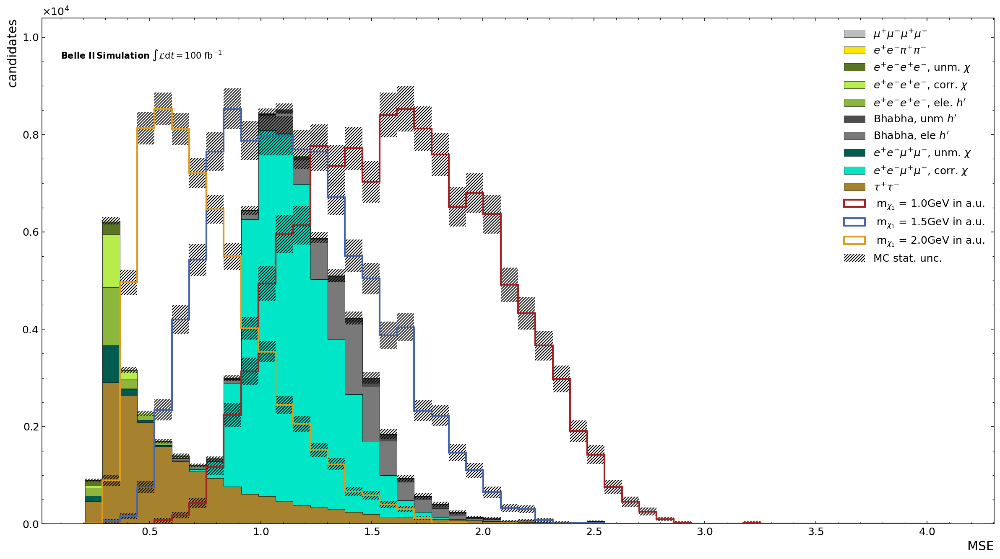

In [23]:
fig, axes = plot_variable_by(bkg_df, mse_var, bkg_subclasses, sig_dfs.values(), sig_mp.values())
axes.legend()
plt.savefig(f"{savepath}/mse.pdf")
plt.savefig(f"{savepath}/mse.jpg")

## Footprintplots

### Latent Variable

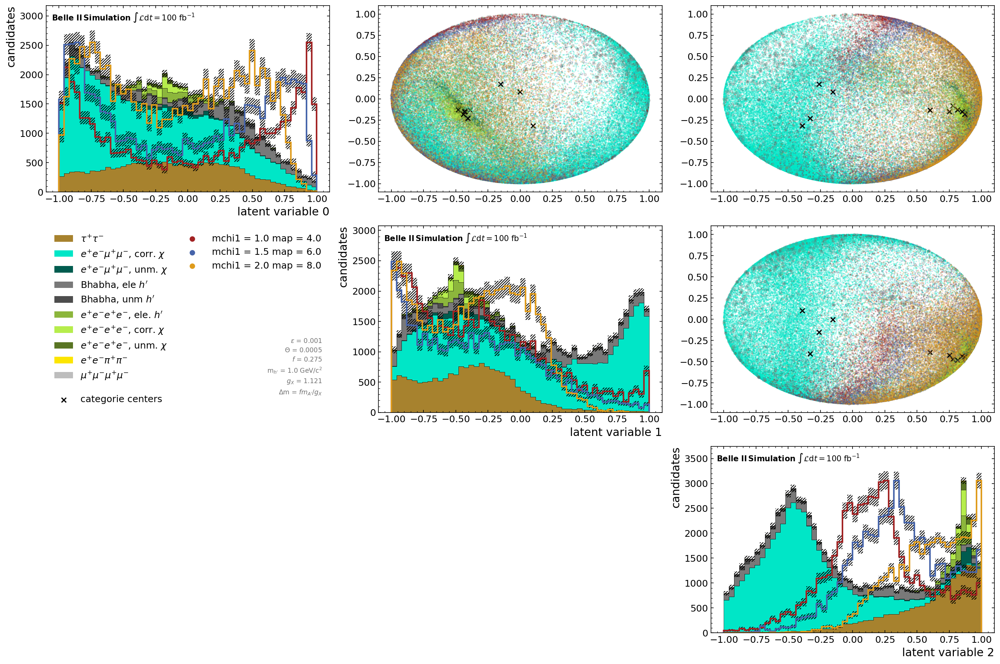

In [24]:
if len(latent_vars) > 1:
    fig, axes = plot_correlation_footprints_cluster(bkg_df, latent_vars, bkg_subclasses, sig_dfs.values(), sig_mp.values(), ellipse_classes = None)
else:
    fig, axes = plot_variable_by(bkg_df, latent_vars[0], bkg_subclasses, sig_dfs.values(), sig_mp.values())
    axes.legend()
plt.savefig(f"{savepath}/latent.pdf")
plt.savefig(f"{savepath}/latent.jpg")

## Reconstruction comparison

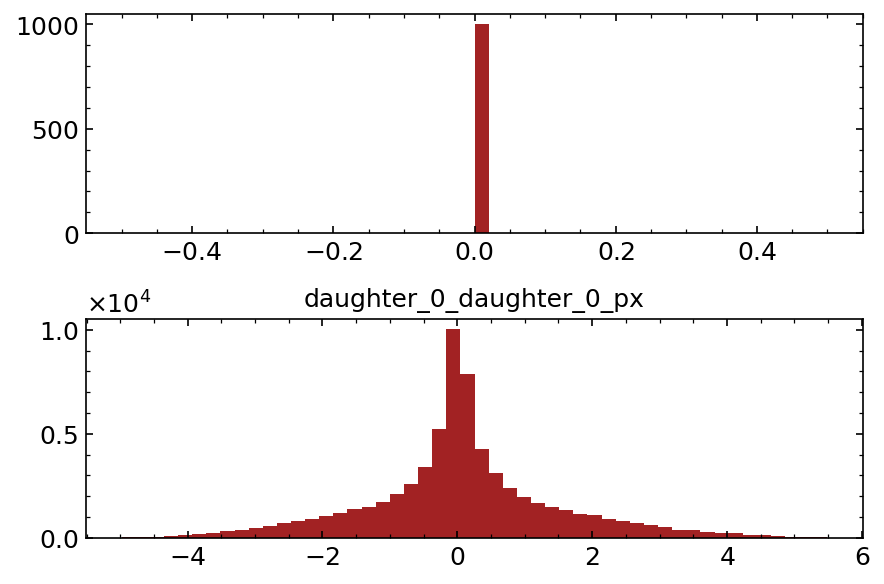

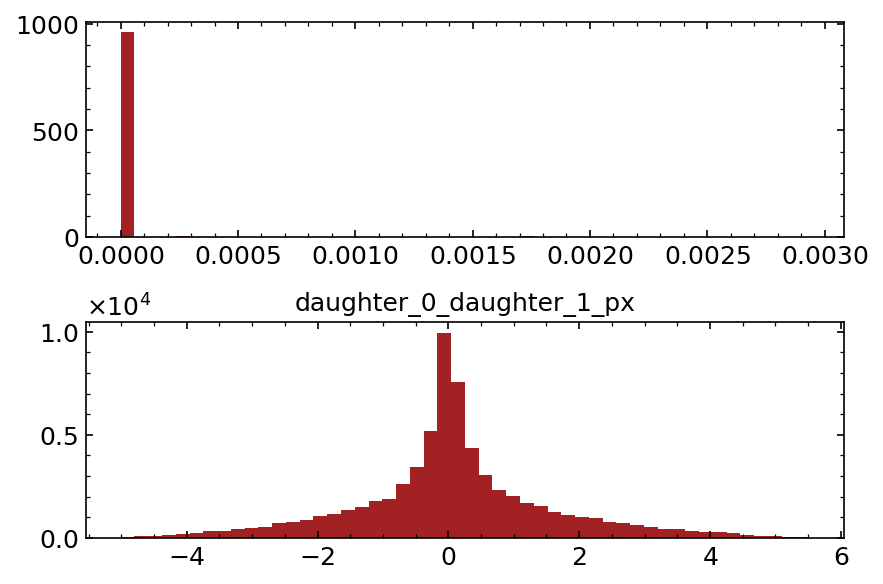

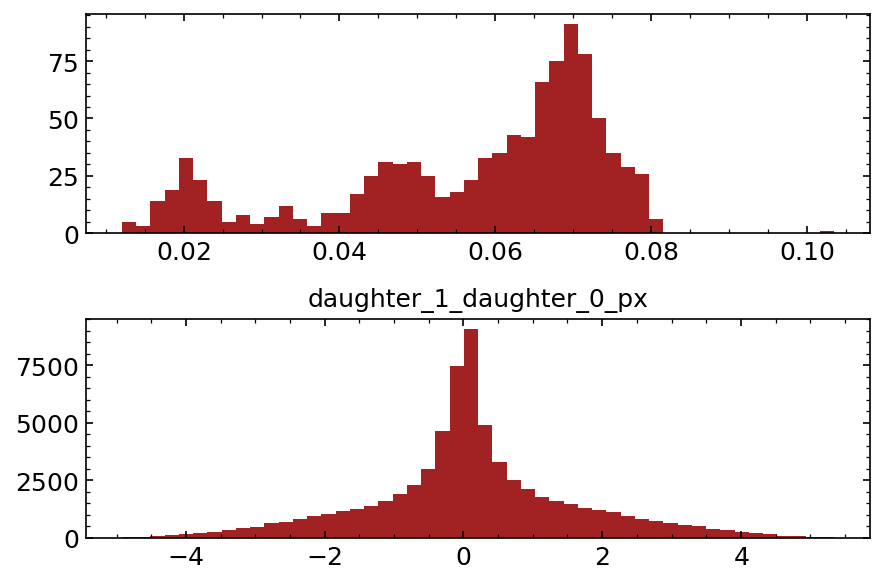

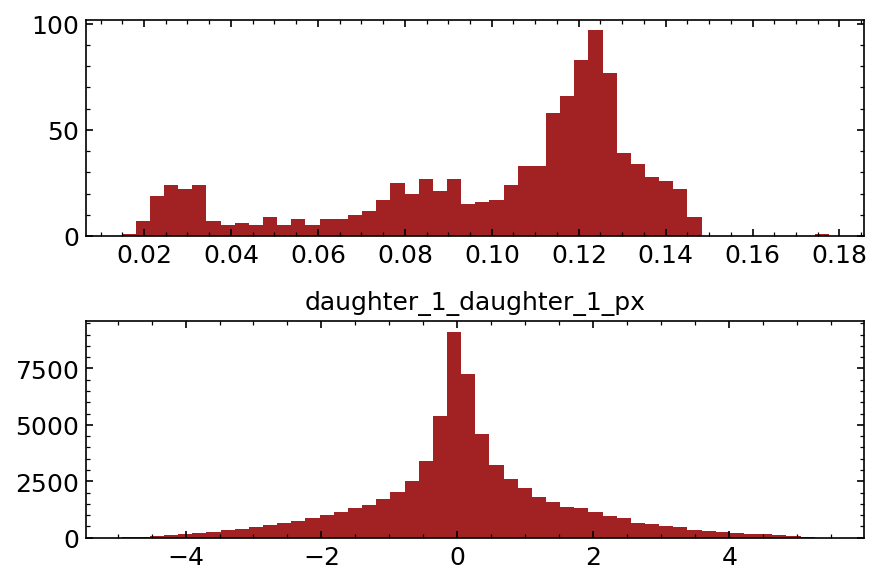

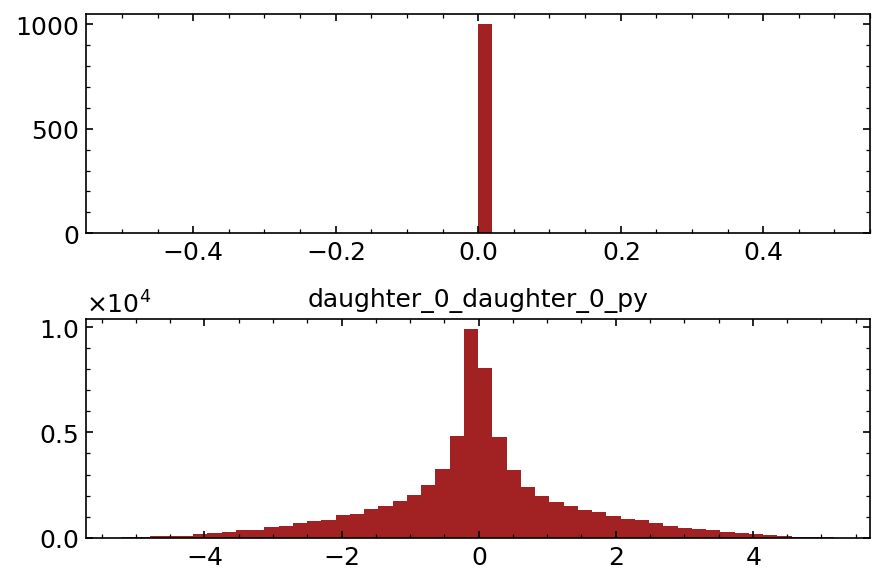

...

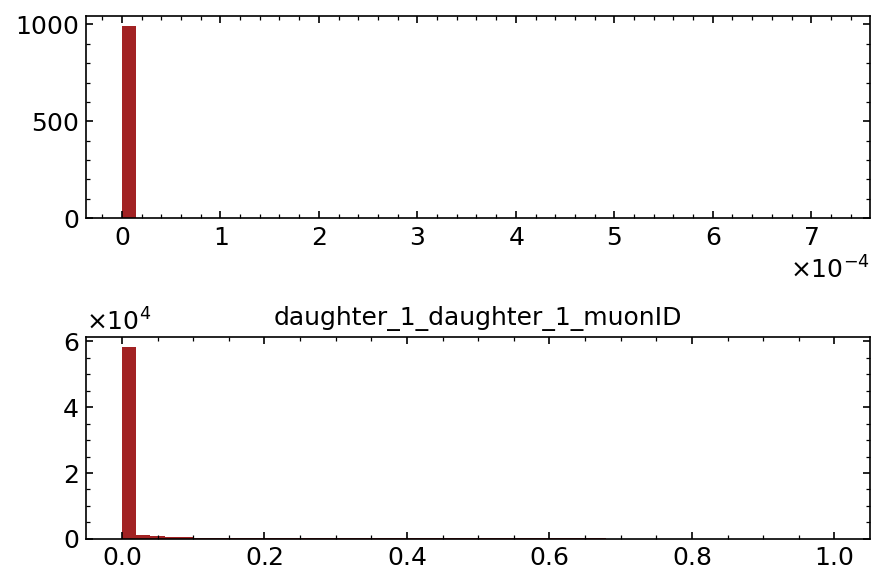

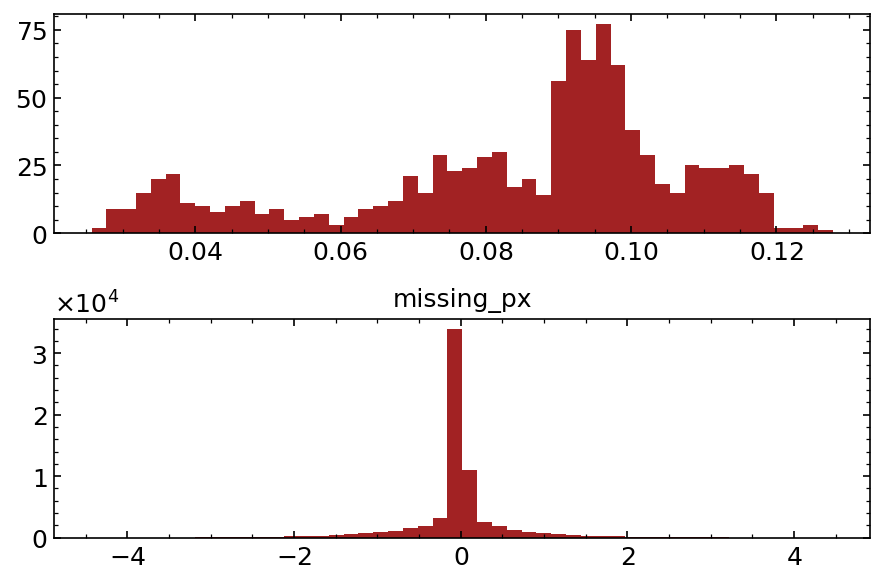

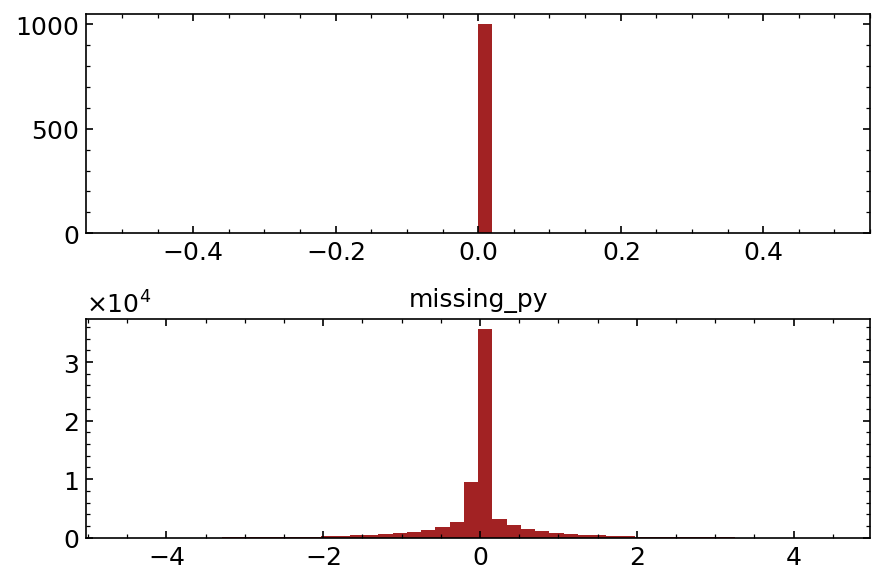

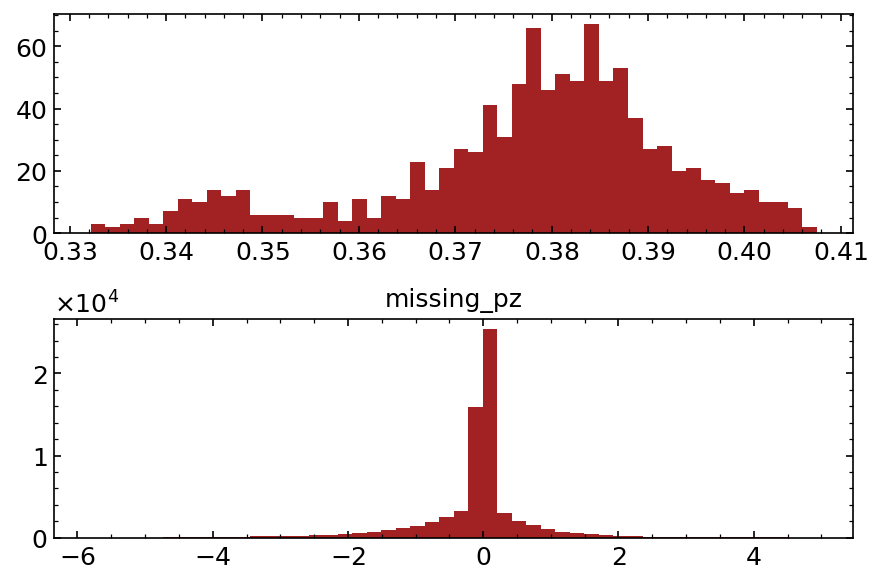

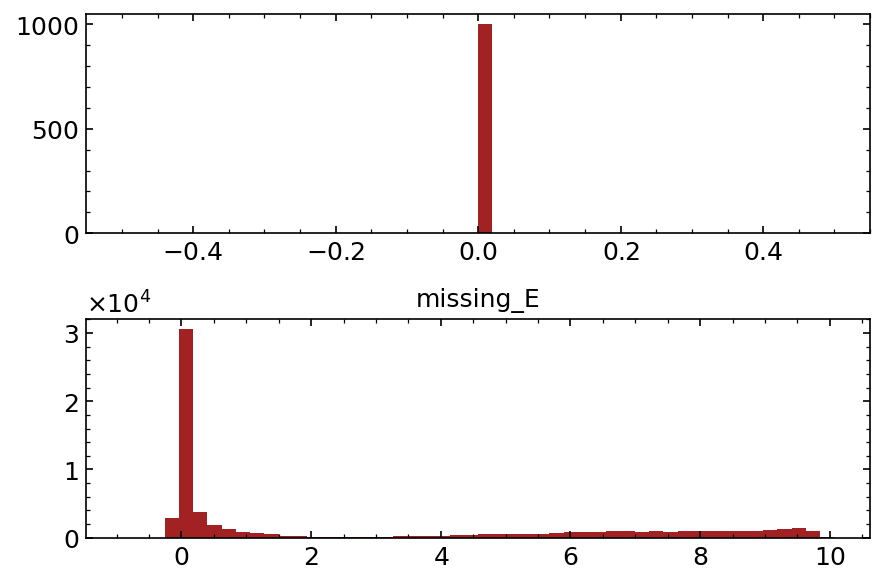

In [25]:
arr = np.load("/ceph/jeppelt/exports/NAE/IDMDH_nae/run/nae_neg_1.npy")
for i, x in enumerate(arr.T):
    fig, axes = plt.subplots(2)
    col = train_column_names[i]
    axes[0].hist(x, bins = 50)
    axes[1].hist(bkg_df[col], bins = 50)
    plt.title(col)
    plt.show()

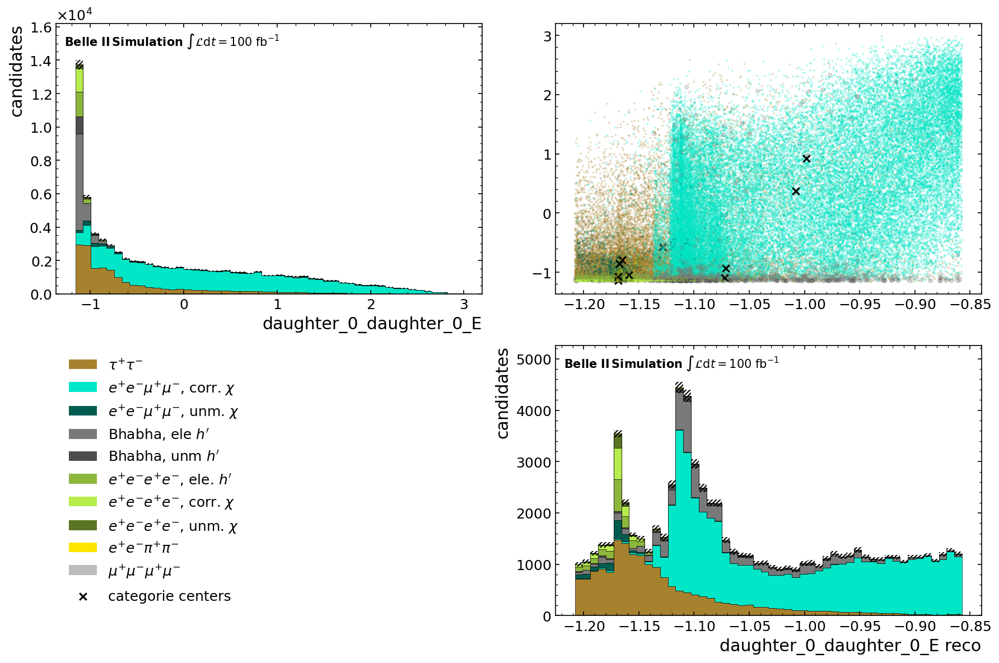

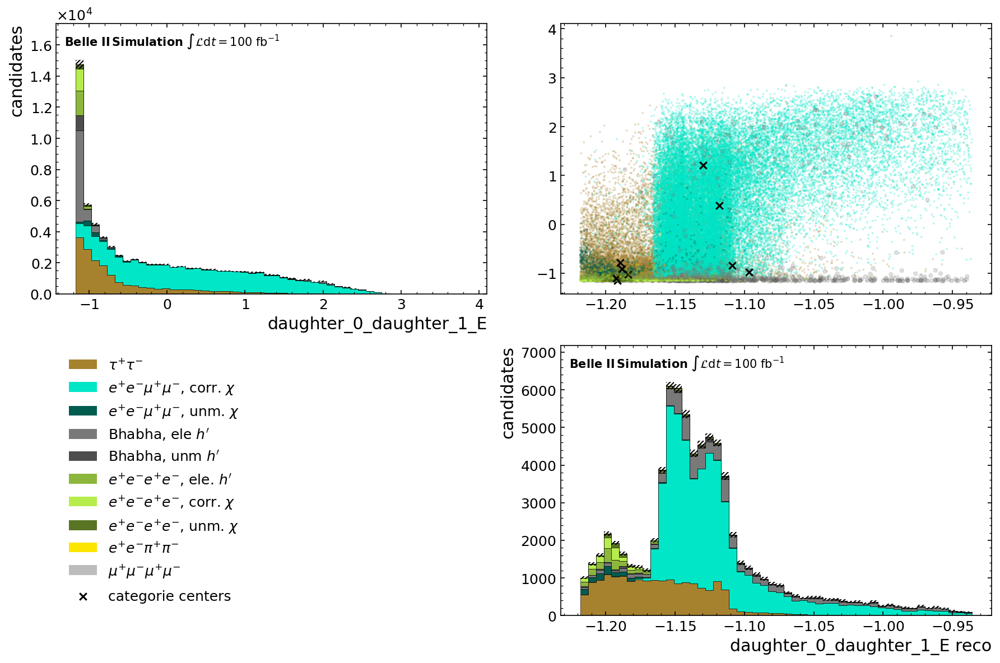

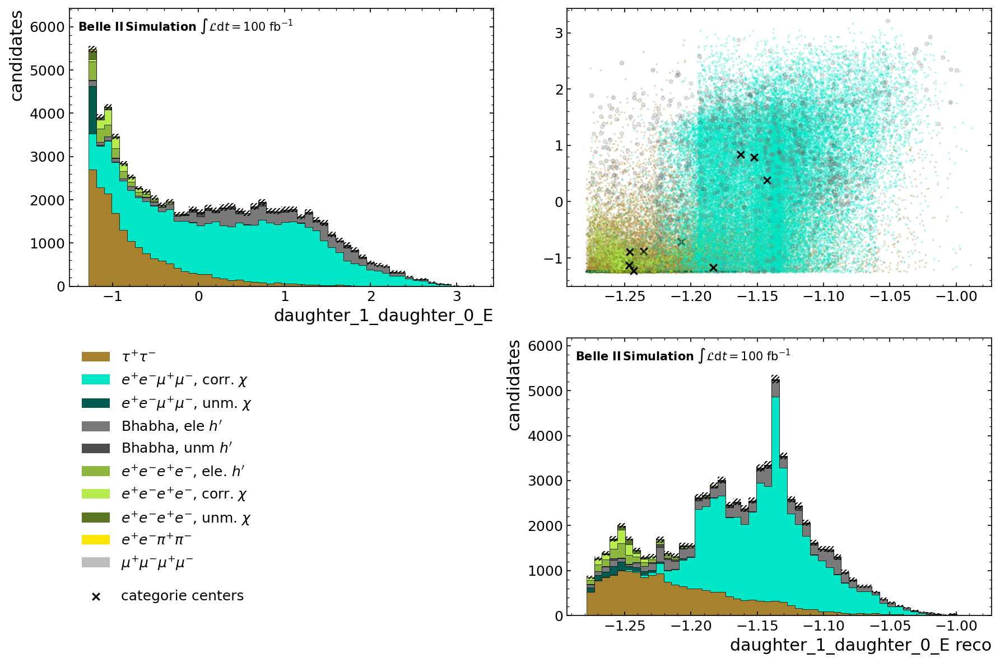

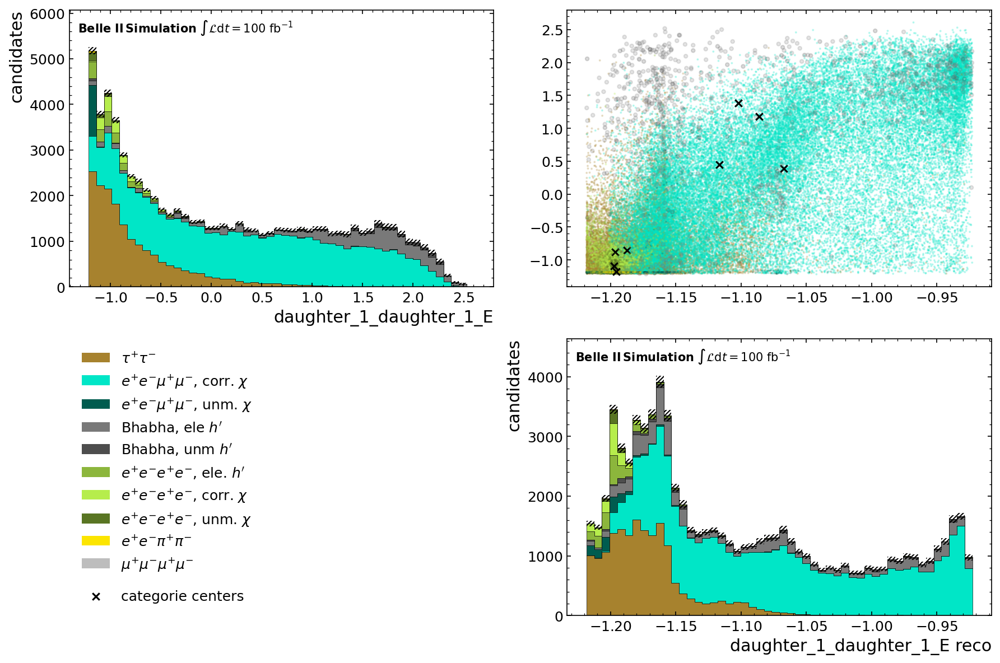

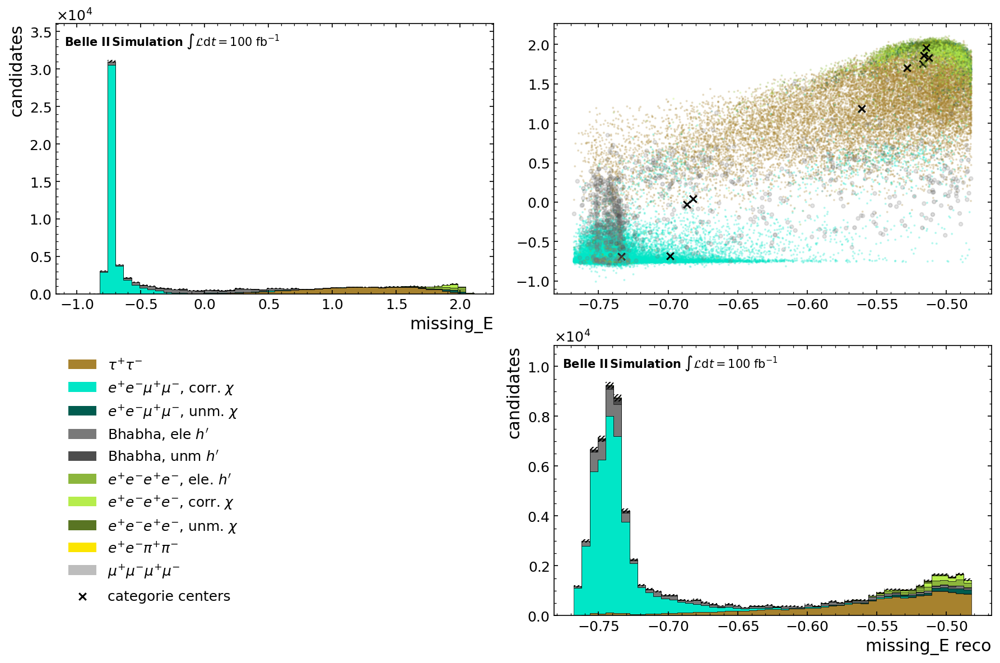

...

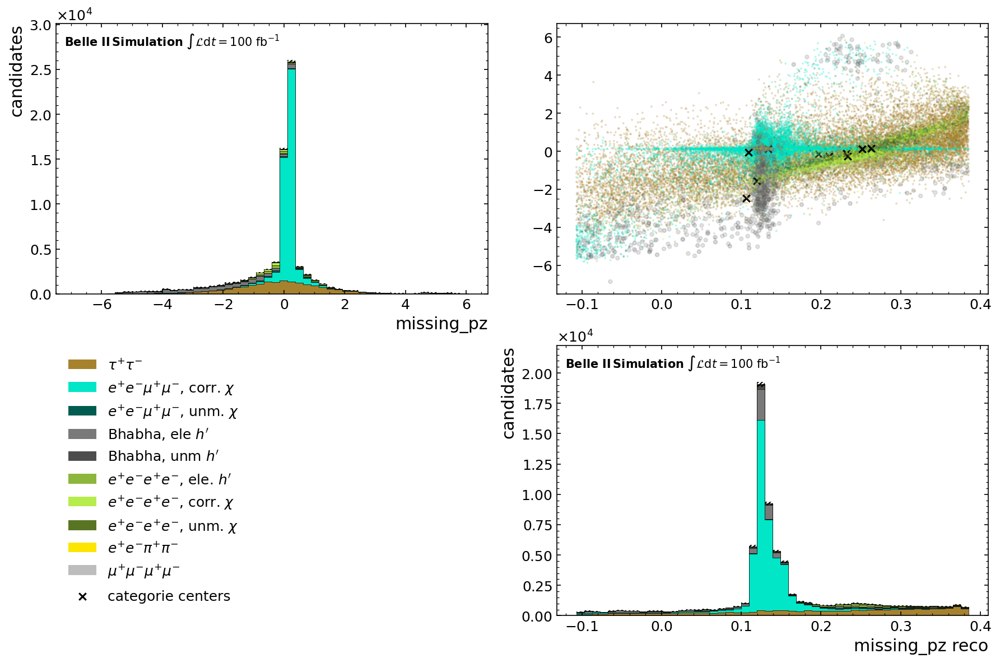

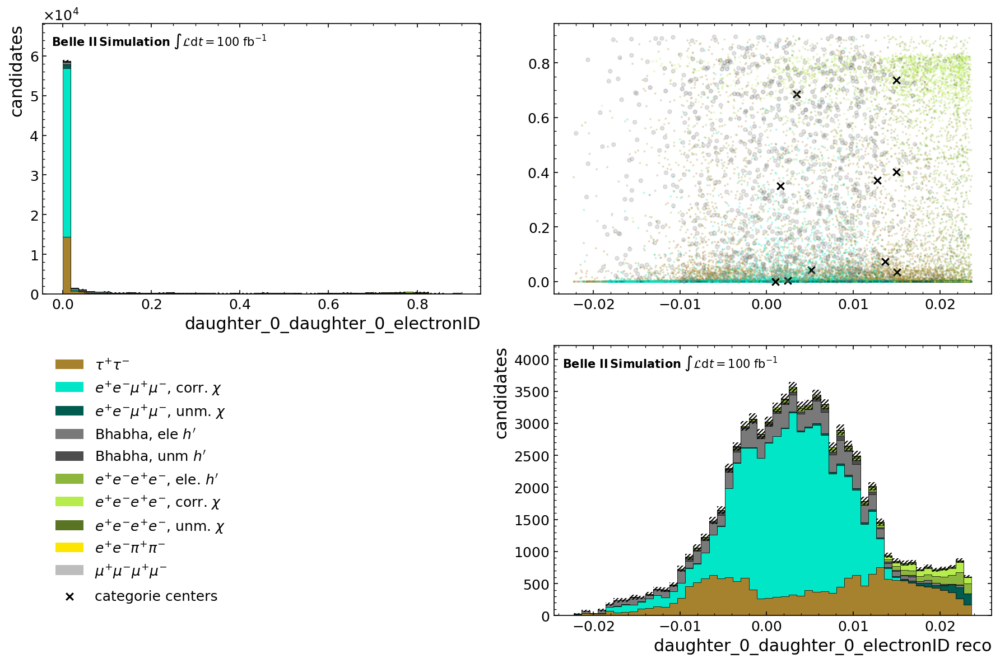

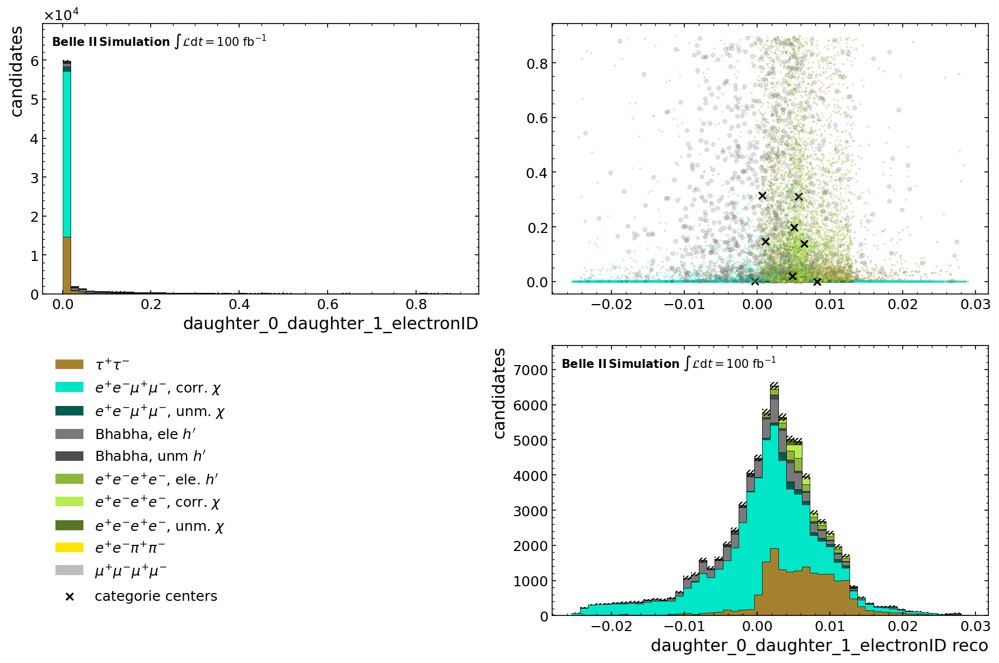

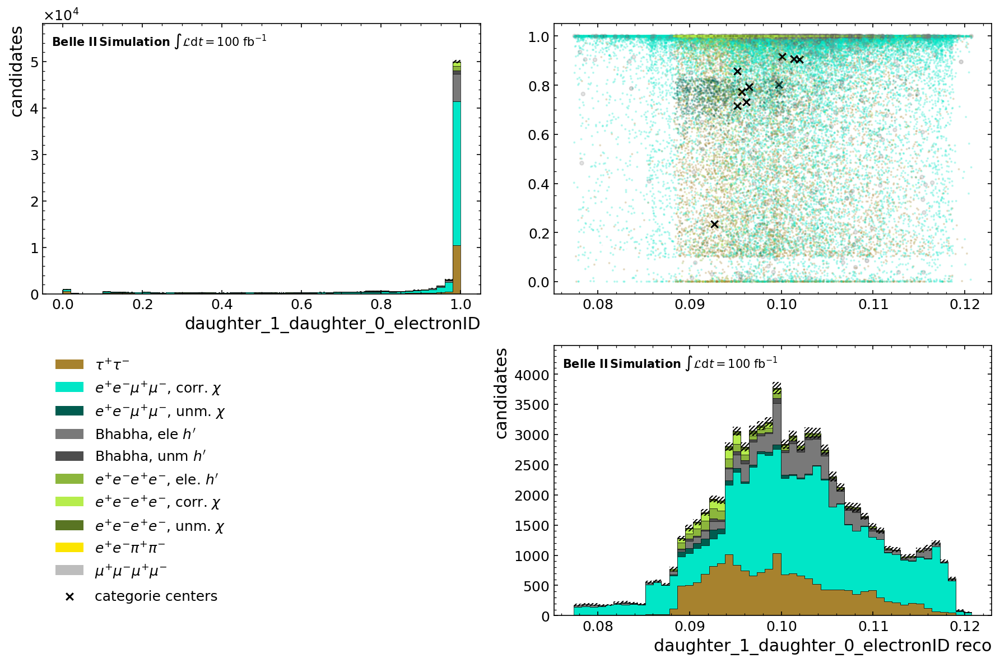

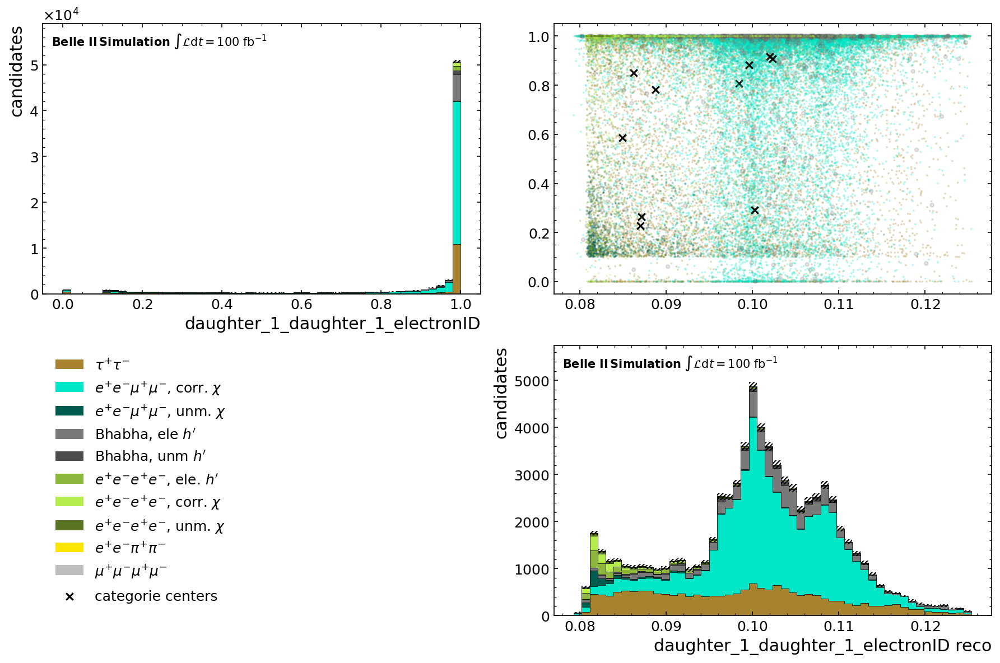

In [ ]:
for var in reco_vars:
    reco_var = copy(var)
    reco_var._df_label = f"{var.df_label}_reco"
    reco_var._label = f"{var.label} reco"
    fig, axes = plot_correlation_footprints_cluster(bkg_df, [var,reco_var], bkg_subclasses, ellipse_classes = None)
    plt.savefig(f"{savepath}/reco_comparison/{var.df_label}.jpg")
    plt.show()